# SVM и его ядра

В этом задании нам предстоит решить задачу SVM при помощи `cvxopt` и применить ее к искуственным данным. Затем аналогичным способом нужно будет решить задачу ядерного SVM и исследовать его поведение для различных ядер и значений их параметров.

In [ ]:
import random
from typing import Callable

import matplotlib.pyplot as plt
import numpy as np
from cvxopt import matrix, solvers
from sklearn.datasets import make_blobs, make_moons

solvers.options["show_progress"] = False

In [ ]:
SEED = 7
np.random.seed(SEED)
random.seed(SEED)

In [ ]:
def visualize(clf, X, y):
    x_min, x_max = X[:, 0].min(), X[:, 0].max()
    y_min, y_max = X[:, 1].min(), X[:, 1].max()
    x_border = (x_max - x_min) / 20 + 1.0e-3
    x_h = (x_max - x_min + 2 * x_border) / 200
    y_border = (y_max - y_min) / 20 + 1.0e-3
    y_h = (y_max - y_min + 2 * y_border) / 200

    cm = plt.cm.Spectral

    xx, yy = np.meshgrid(
        np.arange(x_min - x_border, x_max + x_border, x_h), np.arange(y_min - y_border, y_max + y_border, y_h)
    )
    mesh = np.c_[xx.ravel(), yy.ravel()]

    z_class = clf.predict(mesh).reshape(xx.shape)

    # Put the result into a color plot
    plt.figure(1, figsize=(8, 8))
    plt.pcolormesh(xx, yy, z_class, cmap=cm, alpha=0.3, shading="gouraud")

    # Plot hyperplane and margin
    z_dist = clf.decision_function(mesh).reshape(xx.shape)
    plt.contour(xx, yy, z_dist, [0.0], colors="black")
    plt.contour(xx, yy, z_dist, [-1.0, 1.0], colors="black", linestyles="dashed")

    # Plot also the training points
    y_pred = clf.predict(X)

    ind_support = []
    ind_correct = []
    ind_incorrect = []
    for i in range(len(y)):
        if i in clf.support:
            ind_support.append(i)
        elif y[i] == y_pred[i]:
            ind_correct.append(i)
        else:
            ind_incorrect.append(i)

    plt.scatter(
        X[ind_correct, 0], X[ind_correct, 1], c=y[ind_correct], cmap=cm, alpha=1.0, edgecolor="black", linewidth=0.8
    )
    plt.scatter(
        X[ind_incorrect, 0],
        X[ind_incorrect, 1],
        c=y[ind_incorrect],
        cmap=cm,
        alpha=1.0,
        marker="*",
        s=50,
        edgecolor="black",
        linewidth=0.8,
    )
    plt.scatter(
        X[ind_support, 0],
        X[ind_support, 1],
        c=y[ind_support],
        cmap=cm,
        alpha=1.0,
        edgecolor="yellow",
        linewidths=1.0,
        s=40,
    )

    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.tight_layout()

In [ ]:
def generate_moons_dataset(n_points=1000, noise=0.075):
    X, y = make_moons(n_points, noise=noise, random_state=SEED)
    return X, 2 * y - 1

def generate_blobs_dataset(n_points=1000, n_features=2):
    X, y = make_blobs(n_points, n_features, centers=[[0, 0], [-4, 2], [3.5, -2.0], [3.5, 3.5]], random_state=SEED)
    y = 2 * (y % 2) - 1
    return X, y

X_moons, y_moons = generate_moons_dataset()
X_blobs, y_blobs = generate_blobs_dataset()

### Задание 1 (2 балла)
Для начала реализуем обычный линейный SVM.

#### Методы
`fit(X, y)` - обучает SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Поля
`support` - индексы опорных элементов

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

А наша задача формулируется так:

$\begin{cases}0.5 \cdot w^\text{T}w + C \cdot \sum \xi_i \rightarrow \min_{w, \xi} \\ \xi \geq 0 \\ y_i (w^\text{T}x_i + w_0) \geq 1 - \xi_i \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = (w, w_0, \xi) \\ P =
\left[
    \begin{array}{c|c}
      I & 0\\
      \hline
      0 & 0
    \end{array}
\right] \\
q = \left[
    \begin{array}{c}
      0 \\
      \hline
      C
    \end{array}
\right] \\
 G =
\left[
    \begin{array}{c|c|c}
      0 & 0 & -I\\
      \hline
      -yX & -y & -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      0 \\
      \hline
      -1
    \end{array}
\right] $

In [ ]:
class LinearSVM:
    def __init__(self, C: float):
        """SVM with linear kernel

        Args:
            C: Soft margin coefficient.
        """
        self.C = C
        self.support = None
        self._weights = None
        self._bias = None

    def fit(self, X: np.ndarray, y: np.ndarray):
        """Fit SVM using cvxopt.solvers.qp

        Args:
            X: Train data, [n_samles, n_features]
            y: Binary labels (-1 or +1), [n_samples,]
        """
        n_samples, n_features = X.shape
        y = y.reshape(-1, 1)

        P = np.zeros((n_features + 1 + n_samples, n_features + 1 + n_samples))
        P[:n_features, :n_features] = np.eye(n_features)

        q = np.zeros((n_features + 1 + n_samples, 1))
        q[n_features + 1:] = self.C

        G_main = np.zeros((n_samples, n_features + 1 + n_samples))
        G_main[:, :n_features] = -y * X
        G_main[:, n_features] = -y[:, 0]
        G_main[:, n_features + 1:] = -np.eye(n_samples)

        G_slack = np.zeros((n_samples, n_features + 1 + n_samples))
        G_slack[:, n_features + 1:] = -np.eye(n_samples)

        G = np.vstack([G_slack, G_main])
        h = np.vstack([np.zeros((n_samples, 1)), -np.ones((n_samples, 1))])

        solution = solvers.qp(matrix(P), matrix(q), matrix(G), matrix(h))
        sol = np.array(solution['x']).reshape(-1)

        self._weights = sol[:n_features]
        self._bias = sol[n_features]
        eps = sol[n_features + 1:]

        margins = y.flatten() * self.decision_function(X)
        self.support = np.where((eps > 1e-5) | ((1 - 1e-3 <= margins) & (margins <= 1 + 1e-3)))[0]

    def decision_function(self, X: np.ndarray) -> np.ndarray:
        """Calculate decision for the points, i.e. prediction without sign

        Args:
            X: Input data, [n_samples, n_features]

        Return:
            Decision for each input point, [n_samples, ]
        """

        return X @ self._weights + self._bias


    def predict(self, X: np.ndarray) -> np.ndarray:
        """Classify input points

        Args:
            X: Input data, [n_samples, n_features]

        Return:
            Predicited class for each point (-1 or +1), [n_samples, ]
        """

        return np.sign(self.decision_function(X))


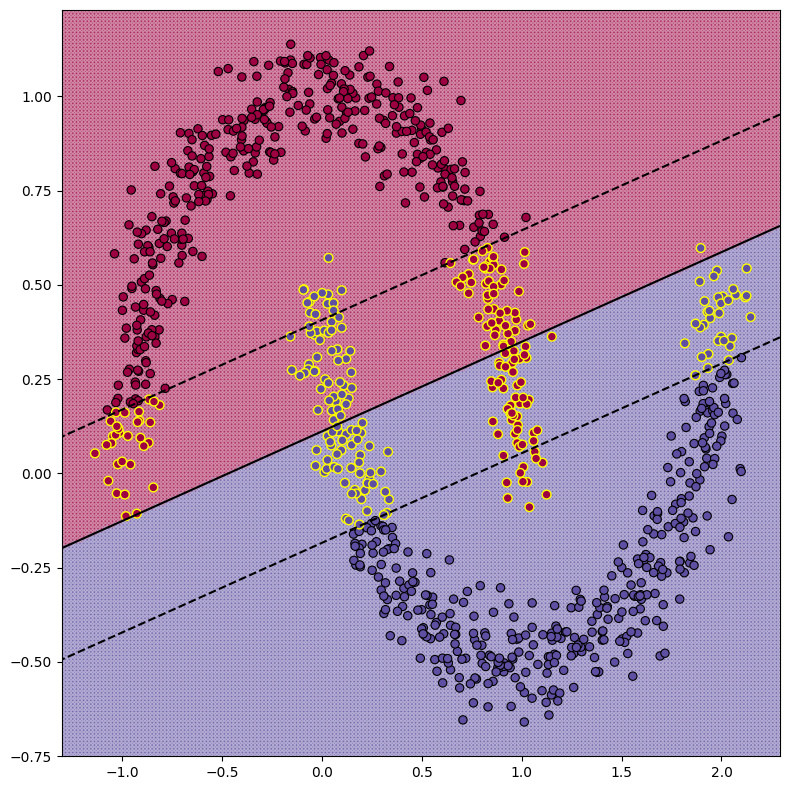

In [ ]:
svm = LinearSVM(1)
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

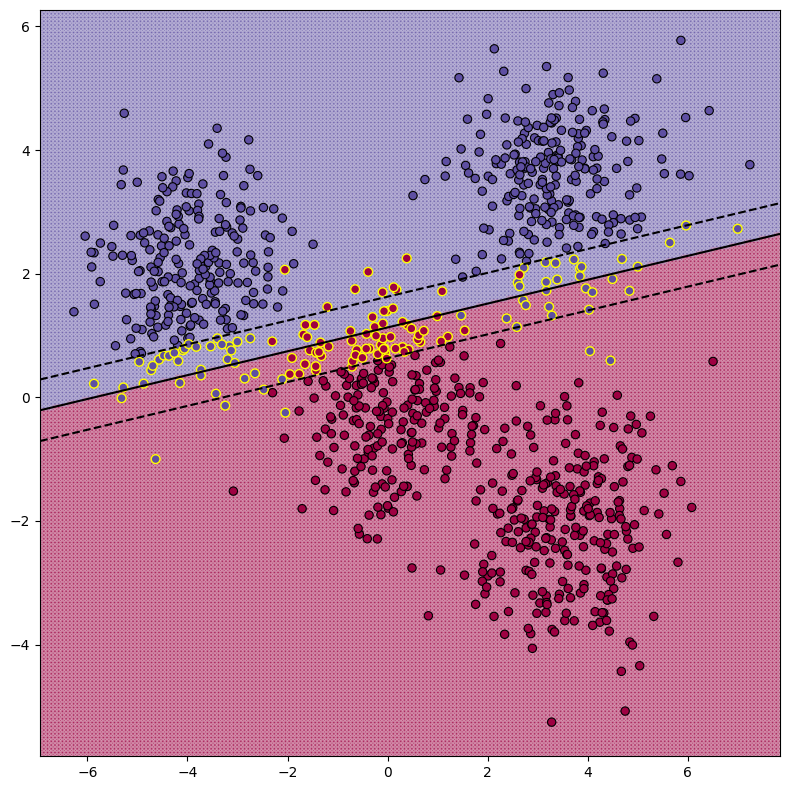

In [ ]:
svm = LinearSVM(1)
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

### Задание 2 (1 балл)
Перед реализацией ядерного SVM, реализуем функции, которые строят ядра.

#### Описание
`get_polynomial_kernel(power)` - возвращает полиномиальное ядро с заданной константой и степенью

`get_gaussian_kernel(sigma=1.)` - возвращает ядро Гаусса с заданным коэффицинтом сигма

In [ ]:
def linear_kernel(x1: np.ndarray, x2: np.ndarray) -> np.ndarray:
    return x1.dot(x2.T)


def get_polynomial_kernel(c=1, power=2):
    def polynomial_kernel(x1: np.ndarray, x2: np.ndarray) -> np.ndarray:
        return (x1 @ x2.T + c) ** power

    return polynomial_kernel


def get_gaussian_kernel(sigma=1.0):

    def gaussian_kernel(x1: np.ndarray, x2: np.ndarray) -> np.ndarray:
      dist_sq = np.linalg.norm(x2 - x1) ** 2
      return np.exp(-dist_sq / (2 * sigma ** 2))

    return gaussian_kernel

### Задание 3 (2 балла)
Теперь перейдем к реализации самого kernel SVM.

#### Описание
`fit(X, y)` - обучает kernel SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

Будем решать двойственную задачу. Формулируется она так:

$\begin{cases}\sum \alpha_i - 0.5 \sum \alpha_i \alpha_j y_i y_j K(x_i, x_j) \rightarrow \max_{\alpha}\\ C \geq \alpha \geq 0 \\ y_i \alpha = 0 \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = \alpha \\ P =
\left[ y_i y_j K(y_i, y_j) \right] \\
q = \left[ -1
\right] \\
 G =
\left[
    \begin{array}{c}
      I\\
      \hline
      -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      C \\
      \hline
      0
    \end{array}
\right] \\
b = 0\\
A = y^\text{T}$

В таком случае решающей функцией будет:

$a(x) = \text{sign} (\sum \alpha_i y_i K(x, x_i) + w_0)$, где $w_0 = \frac{1}{n}\sum\limits_{i=1}^{n}[y_i - \sum \alpha_j y_j K(x_i, x_j)]$

In [ ]:
class KernelSVM:

    _X = None
    _y = None
    w0 = None
    alphas = None

    def __init__(self, C: float, kernel: Callable = linear_kernel):
        """SVM with specified kernel

        Args:
            C: Soft margin coefficient
            kernel: Callable kernel for kernel trick
        """

        self.C = C
        self.kernel = kernel
        self.support = None

    def fit(self, X: np.ndarray, y: np.ndarray):
        """Fit SVM using cvxopt.solvers.qp

        Args:
            X: Train data, [n_samles, n_features]
            y: Binary labels (-1 or +1), [n_samples,]
        """

        self._X = X
        self._y = y.reshape(-1, 1)
        n_samples, n_features = X.shape

        K = np.zeros((n_samples, n_samples))
        for i in range(n_samples):
            for j in range(n_samples):
                K[i, j] = self.kernel(X[i], X[j])

        P = matrix((self._y @ self._y.T) * K)
        q = matrix(-np.ones((n_samples, 1)))
        G = matrix(np.vstack((np.eye(n_samples), -np.eye(n_samples))))
        h = matrix(np.vstack((np.ones((n_samples, 1)) * self.C, np.zeros((n_samples, 1)))))
        A = matrix(self._y.T.astype(np.double))
        b = matrix(0.0)

        sol = solvers.qp(P, q, G, h, A, b)
        self.alphas = np.array(sol['x'])

        self.support = np.where(self.alphas > 1e-5)[0]

        self.w0 = np.mean([self._y[i] - np.sum(self.alphas[self.support] * self._y[self.support] * K[i, self.support][:, None])
                          for i in self.support])


    def decision_function(self, X: np.ndarray) -> np.ndarray:
        """Calculate decision for the points, i.e. prediction without sign

        Args:
            X: Input data, [n_samples, n_features]

        Return:
            Decision for each input point, [n_samples, ]
        """

        result = np.zeros(X.shape[0])
        for i in range(X.shape[0]):
            s = 0
            for j in self.support:
                s += self.alphas[j].item() * self._y[j].item() * self.kernel(X[i], self._X[j]).item()
            result[i] = s + self.w0.item()
        return result


    def predict(self, X: np.ndarray) -> np.ndarray:
        """Classify input points

        Args:
            X: Input data, [n_samples, n_features]

        Return:
            Predicited class for each point (-1 or +1), [n_samples, ]
        """

        return np.sign(self.decision_function(X))


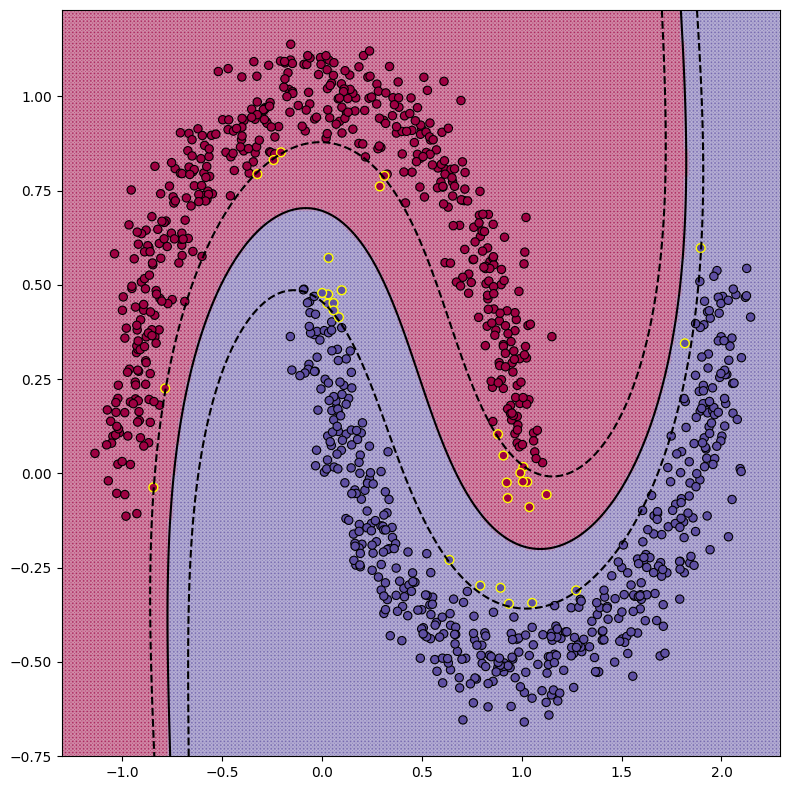

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

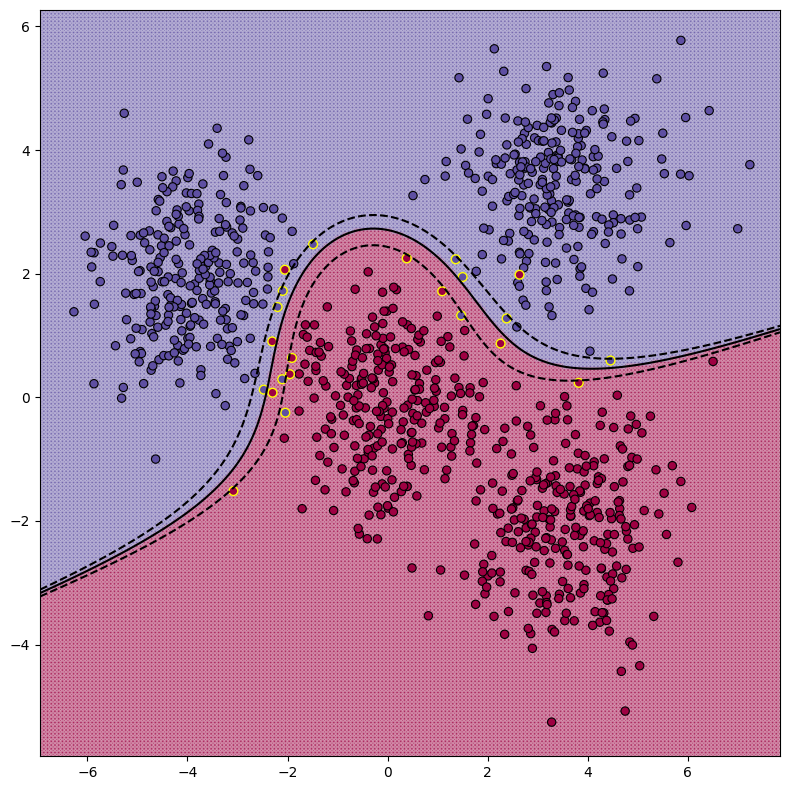

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

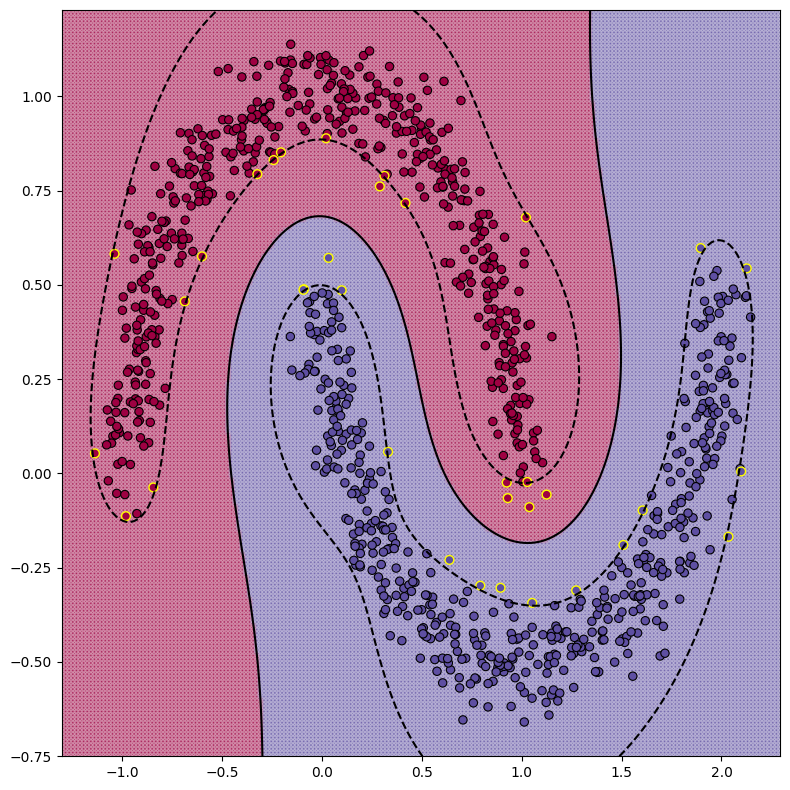

In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

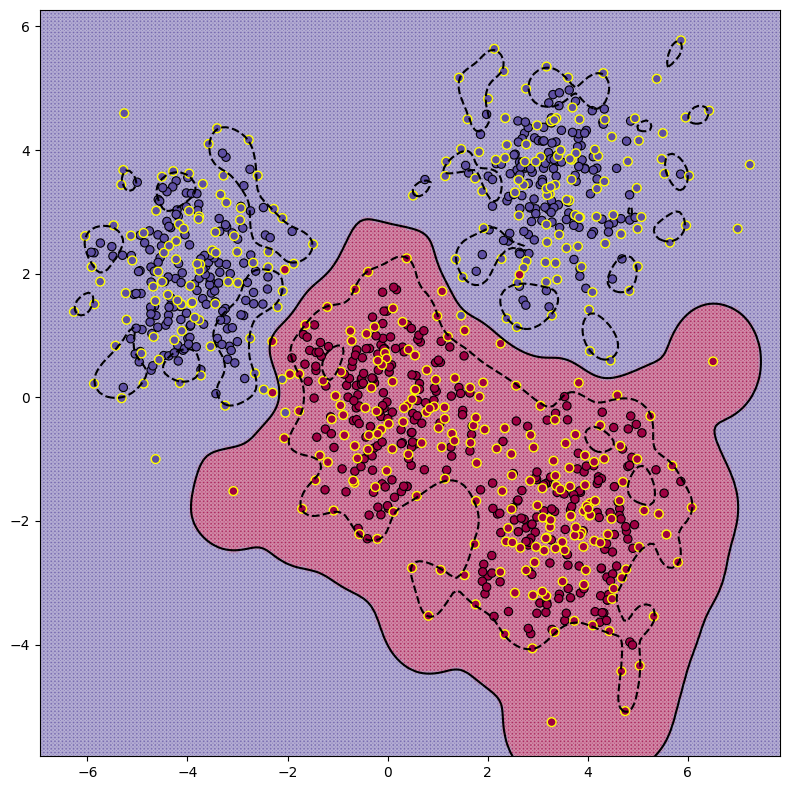

In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

### Задание 4 (2 балла)
Исследуйте и опишите влияние параметров каждого вида ядра на полученный классификатор. Что происходит при увеличении константы в полиномиальном ядре? При увеличении степени? Как влияет на результат сигма в ядре Гаусса?

__При выполнении этого задания стоит написать код, который визуализирует классификаторы с различными ядрами__

### Polynomial kernel

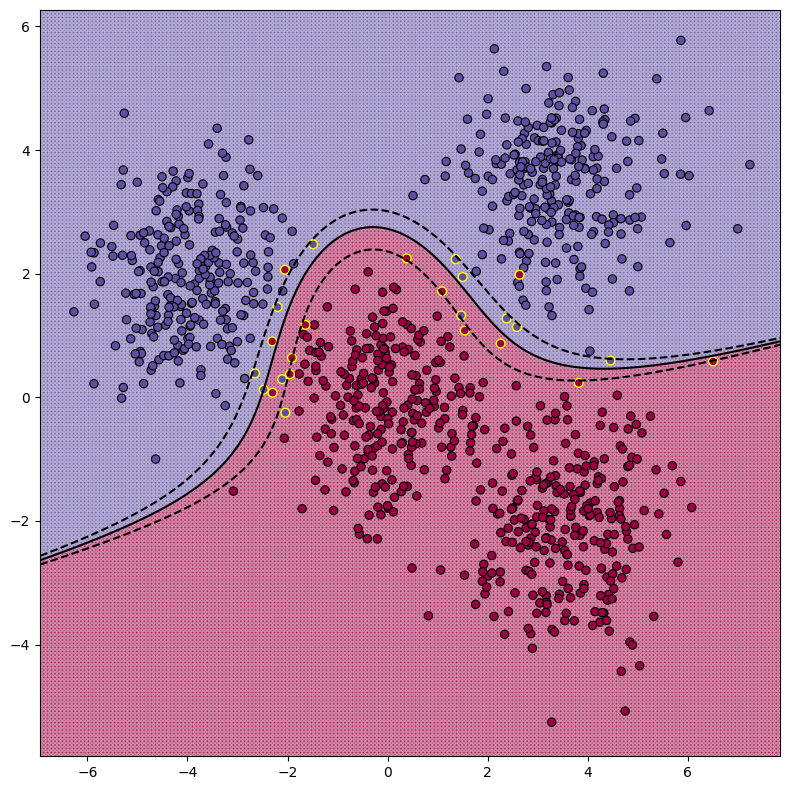

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(0.01, 3))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

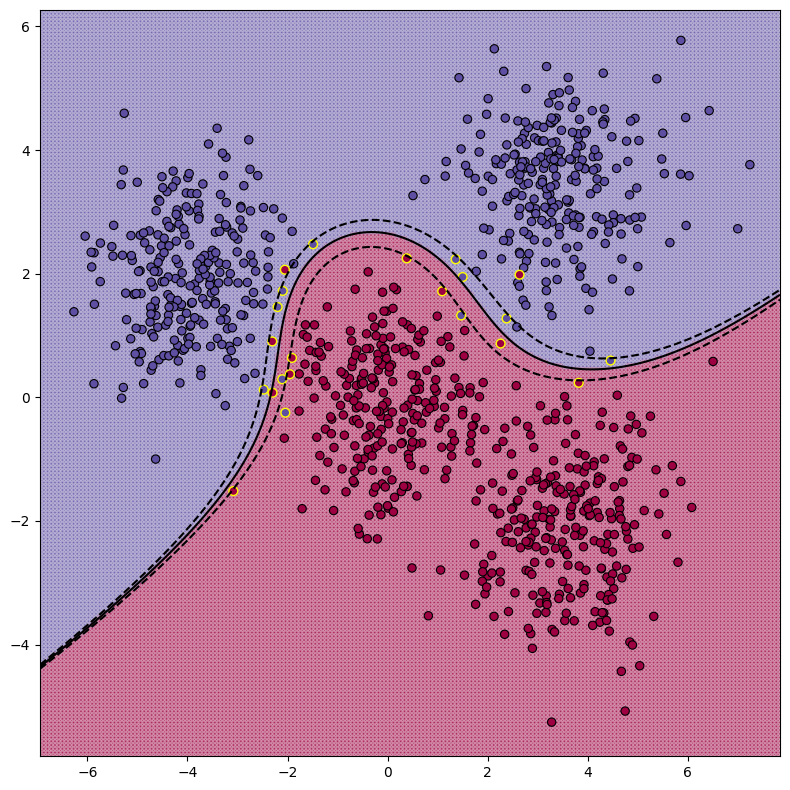

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(10000, 3))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

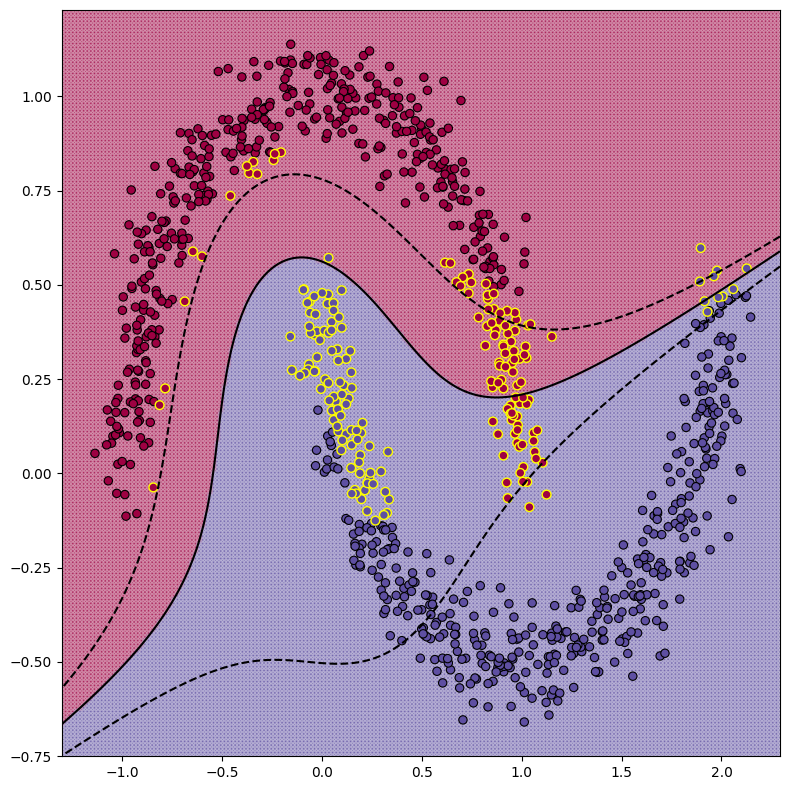

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(0.01, 3))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

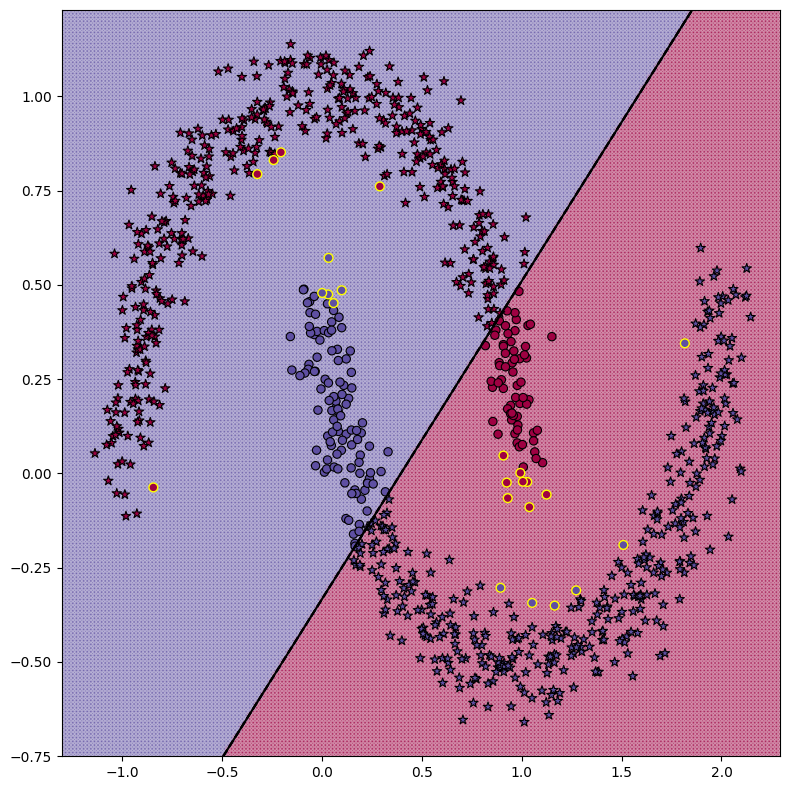

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(10000, 3))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

**Вывод:** В обоих случаях видно, что кривая разделяющей плоскости начинается выше при малом с=0.01 и идет более свободно, чем при больших с. То есть при малых с граница становится более гибкой, а если с большое, то оно является существенным дополнением к произведению из формулы, тем самым делая границу более жесткой и менее подстраиваемой под данные.

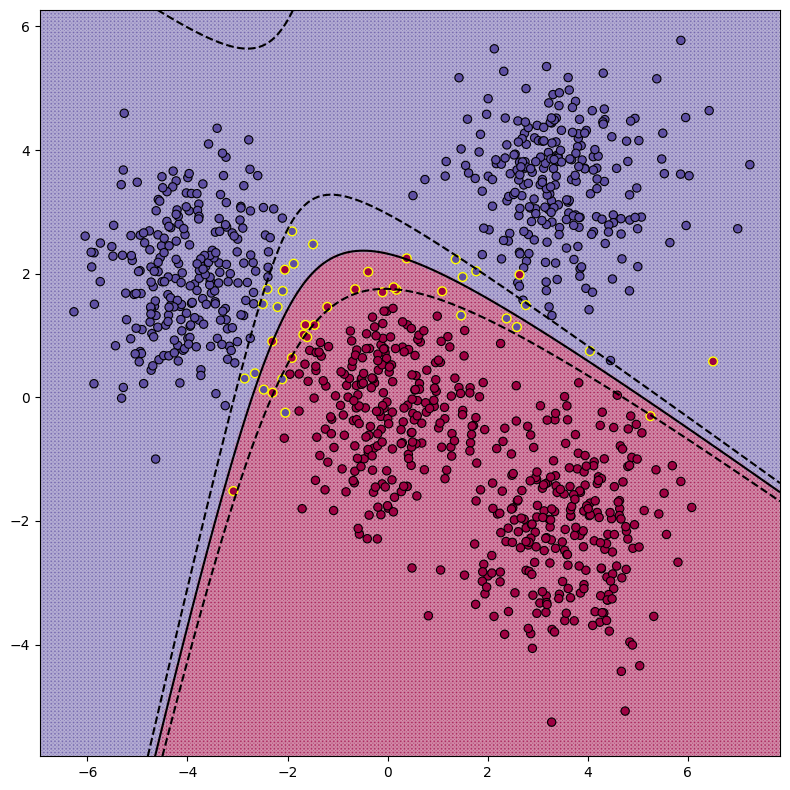

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 2))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

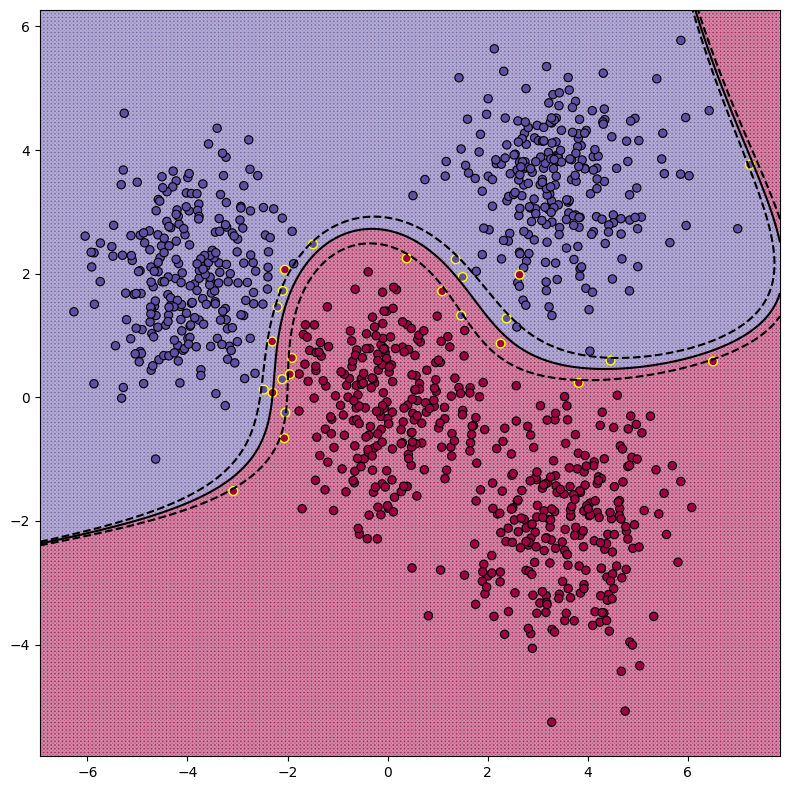

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 4))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

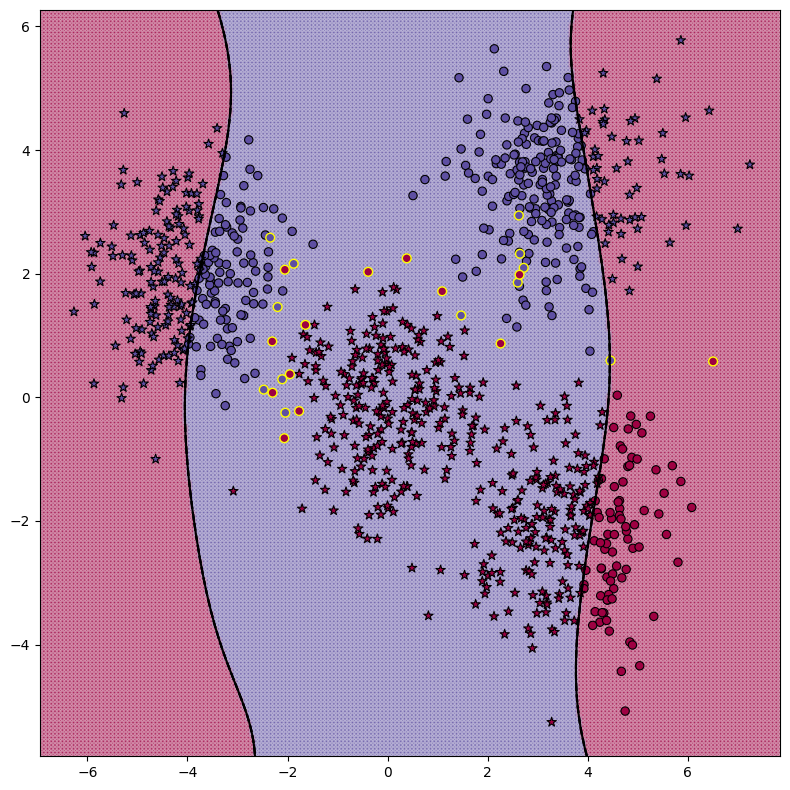

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 8))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

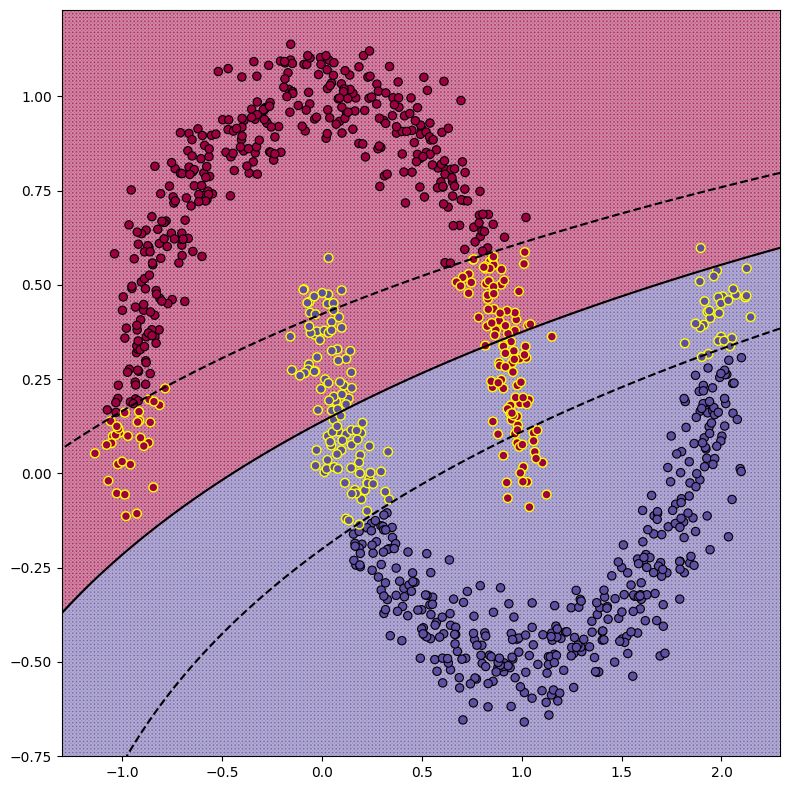

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 2))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

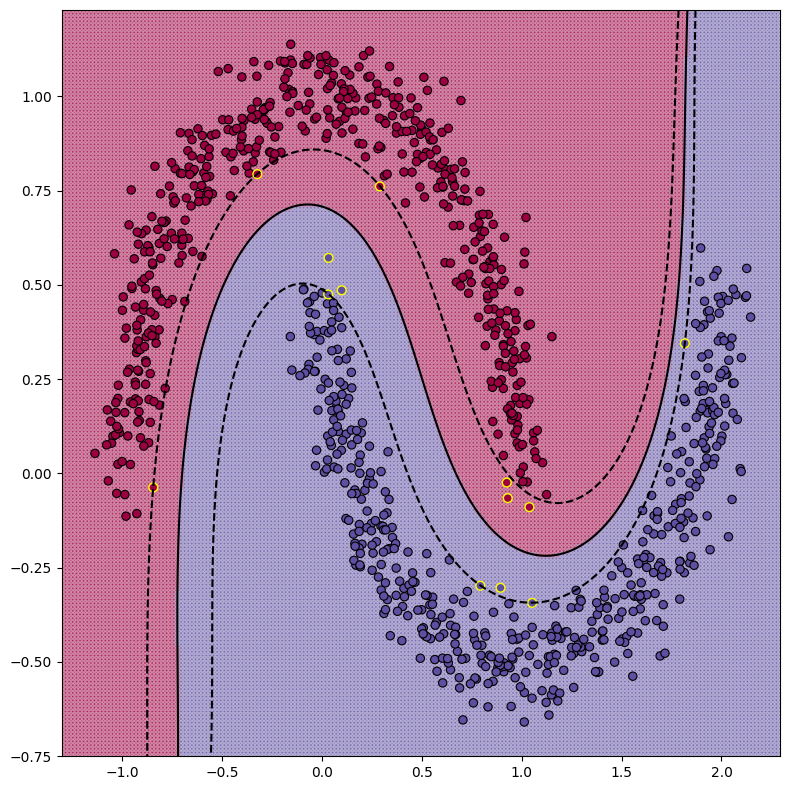

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 4))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

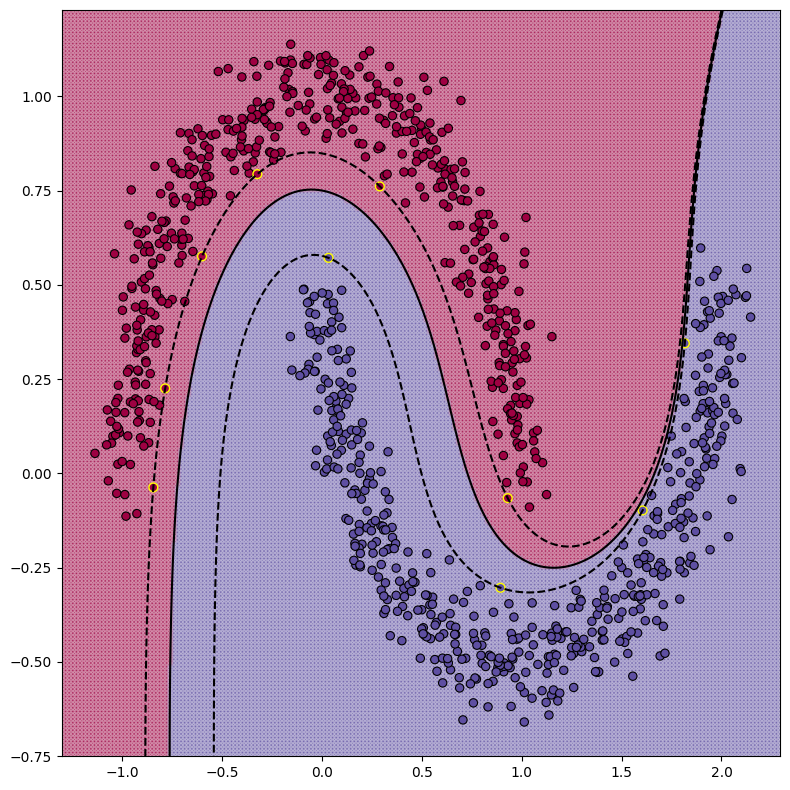

In [ ]:
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 8))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

**Вывод**: Чем больше d, тем более изогнутой становится разделяющая кривая, то есть модель начинает подстраиваться под данные и переобучаться. Чем меньше d, тем ближе к линейному случаю (более грубо делит данные).

### RBF kernel


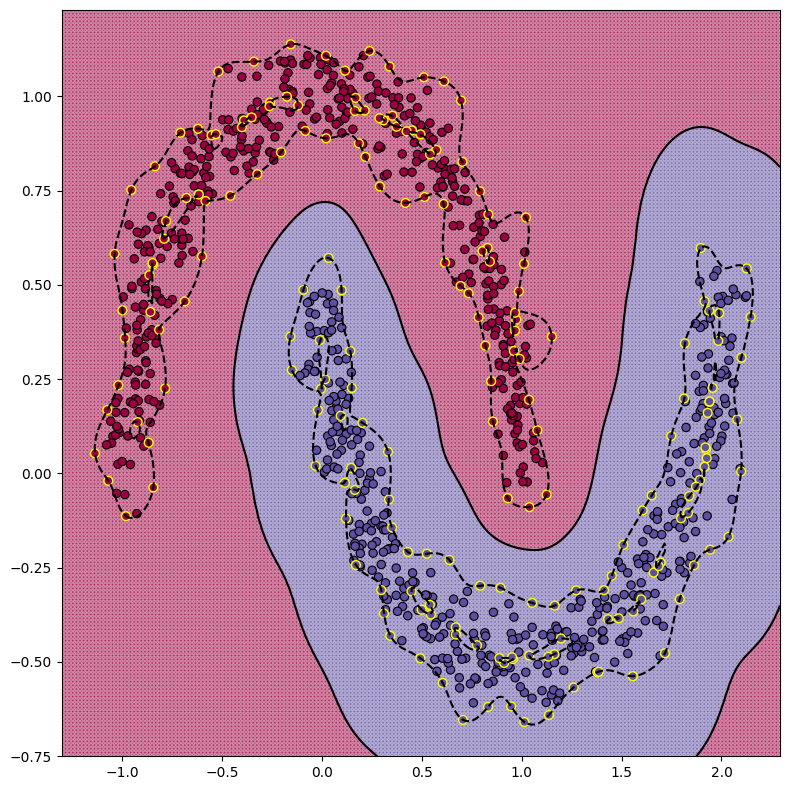

In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.1))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

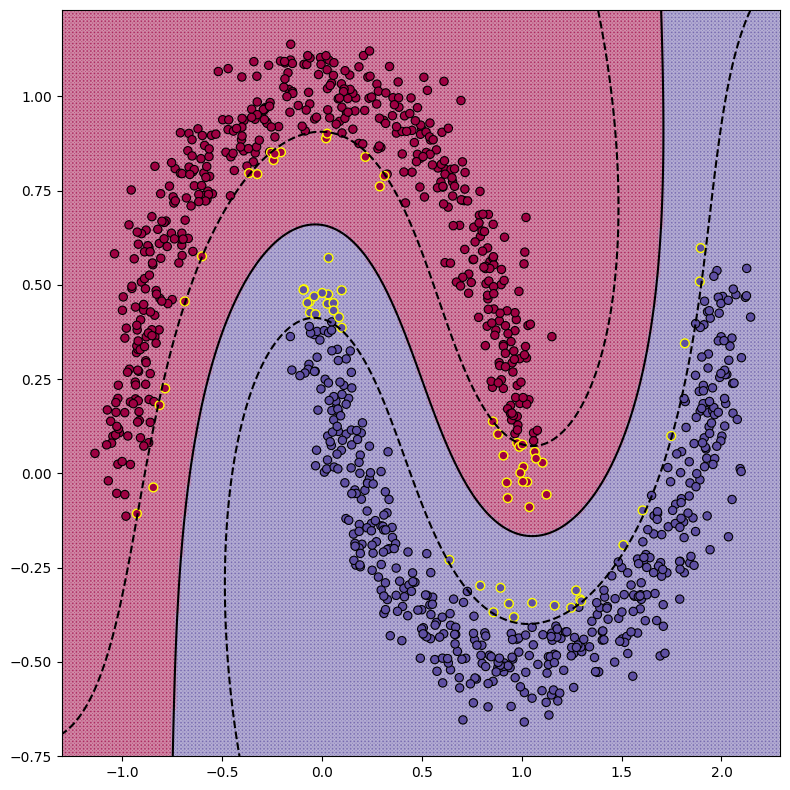

In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.8))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

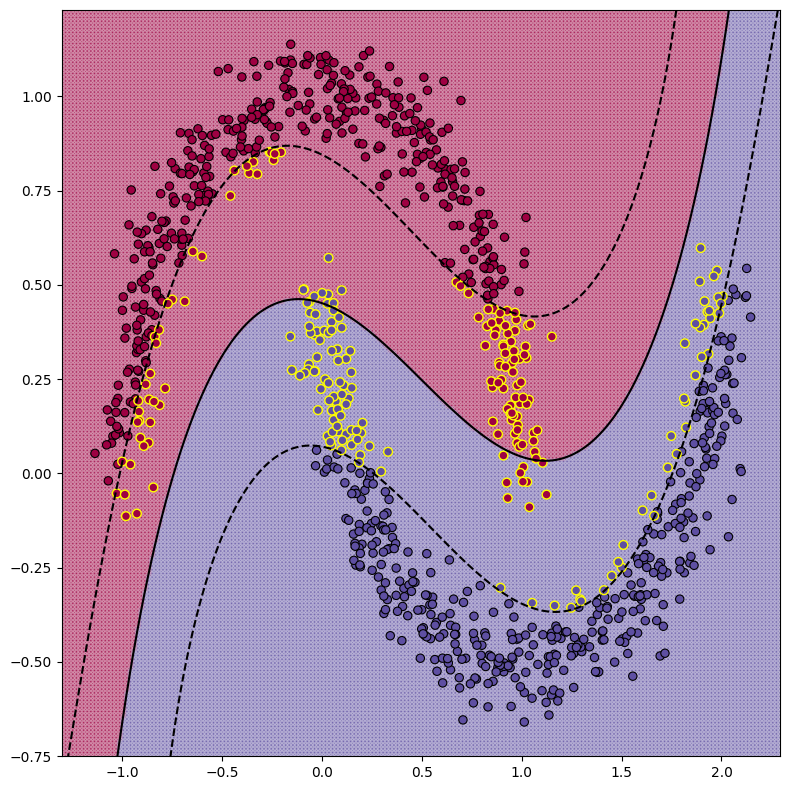

In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(1.5))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

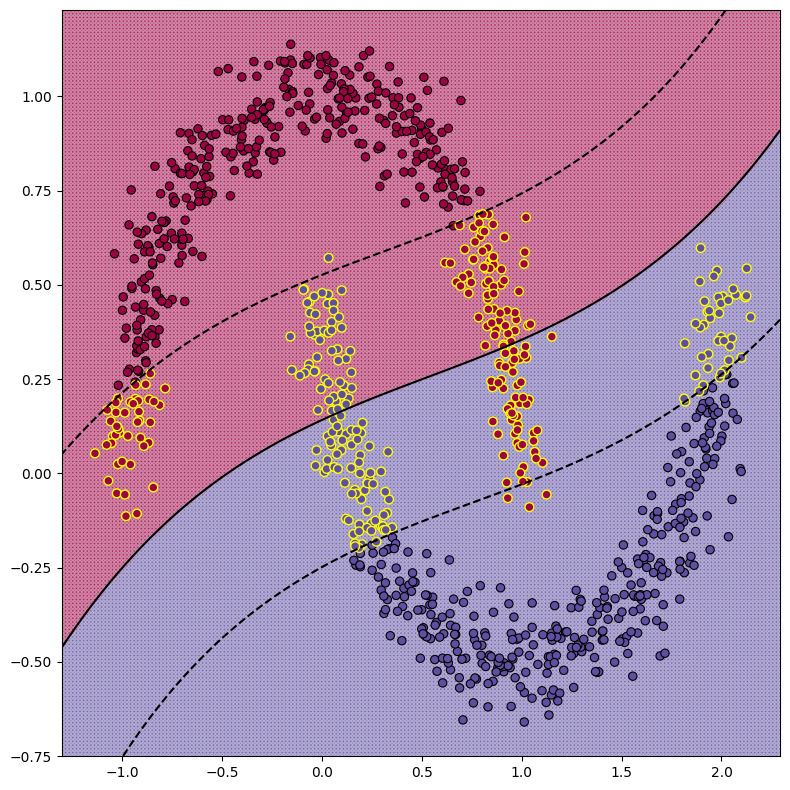

In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(2.5))
svm.fit(X_moons, y_moons)
visualize(svm, X_moons, y_moons)
plt.show()

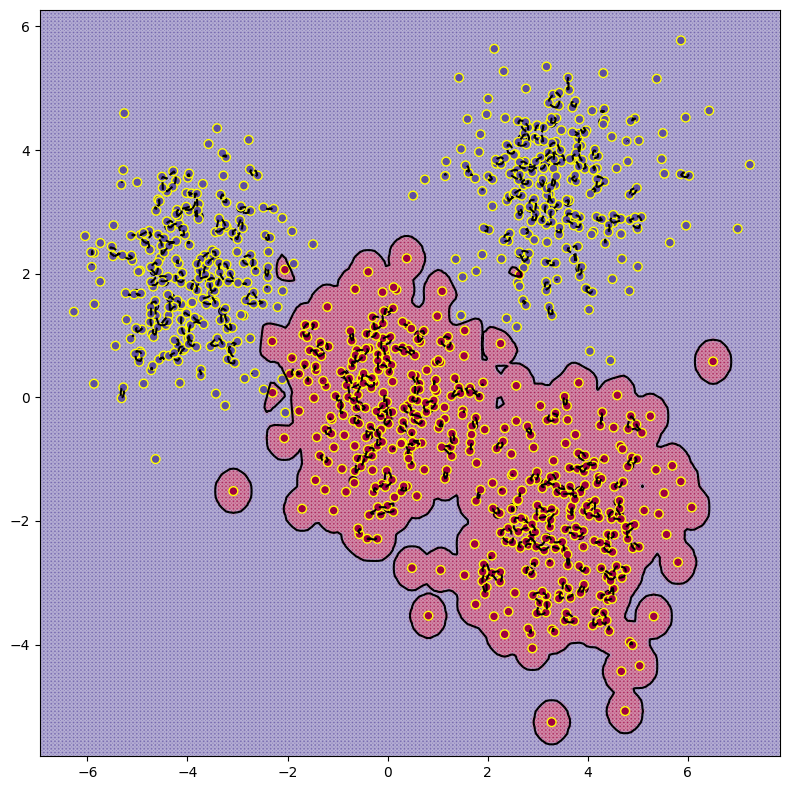

In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.1))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

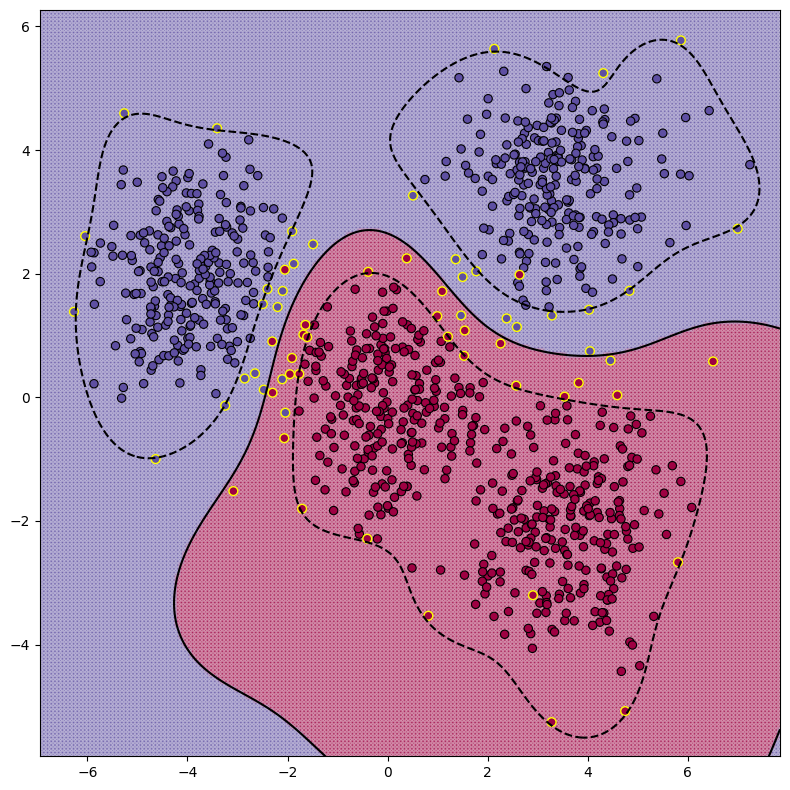

In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(1.5))
svm.fit(X_blobs, y_blobs)
visualize(svm, X_blobs, y_blobs)
plt.show()

**Вывод**: При малых сигма появляется множество локальных контуров (то есть модель переобучается, что особенно заметно в случае с blobs), с увеличением сигмы контуров становится меньше и кривые сглаживаются, что может вызвать недообучение.

# Задание 5 (3 балла)

Поставьте эксперимент и сравните SVM с логистической регрессией на синтетических данных. Для этого для каждого датасета:

1. Воспользуйтесь реализацией логистической регрессии из `sklearn`
2. Подготовьте данные, преобразуйте их для лучшей разделимости, например, добавьте polynomial features
3. Зафиксируйте метрику
4. Подберите гиперпараметры обоих моделей
5. Напишите вывод, какая из моделей обучилась лучше и почему так вышло

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.metrics import f1_score

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_moons, y_moons, test_size=0.2, random_state=42)

poly_degree = 2

In [ ]:
pipe_logreg = Pipeline([
    ('poly', PolynomialFeatures(degree=poly_degree, include_bias=False)),
    ('scaler', StandardScaler()),
    ('logreg', LogisticRegression(max_iter=1000))
])

params_logreg = {
    'logreg__C': [0.01, 0.1, 0.15, 1, 10]
}

grid_logreg = GridSearchCV(pipe_logreg, params_logreg, cv=5)
grid_logreg.fit(X_train, y_train)

y_pred_logreg = grid_logreg.predict(X_test)

print("Accuracy logreg:", accuracy_score(y_test, y_pred_logreg))
print("Best params:", grid_logreg.best_params_)

Accuracy logreg: 0.88
Best params: {'logreg__C': 0.1}


In [ ]:
def get_best_sigma(X, y, sigmas):
    best_score = -np.inf
    best_sigma = None

    folds = KFold(n_splits=5, shuffle=True, random_state=42)

    for sigma in sigmas:
        scores = []

        for train_index, val_index in folds.split(X):
            X_tr, X_val = X[train_index], X[val_index]
            y_tr, y_val = y[train_index], y[val_index]

            model = KernelSVM(1, kernel=get_gaussian_kernel(sigma))
            model.fit(X_tr, y_tr)

            y_pred = model.predict(X_val)

            scores.append(accuracy_score(y_val, y_pred))

        mean_score = np.mean(scores)

        if mean_score > best_score:
            best_score = mean_score
            best_sigma = sigma

    return best_sigma, best_score

In [ ]:
poly = PolynomialFeatures(degree=poly_degree, include_bias=False)
scaler = StandardScaler()

X_poly = poly.fit_transform(X_train)
X_scaled = scaler.fit_transform(X_poly)

X_poly_test = poly.transform(X_test)
X_scaled_test = scaler.transform(X_poly_test)

sigmas = [0.1, 0.4, 1, 2, 2.5, 3, 4, 5]

best_sigma, best_score = get_best_sigma(X_scaled, y_train, sigmas)
print(best_sigma)

0.4


In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(best_sigma))
svm.fit(X_scaled, y_train)

y_pred_svm = svm.predict(X_scaled_test)

print("Accuracy kernel svm:", accuracy_score(y_test, y_pred_svm))

Accuracy kernel svm: 1.0


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_blobs, y_blobs, test_size=0.2, random_state=42)

In [ ]:
grid_logreg = GridSearchCV(pipe_logreg, params_logreg, cv=5)
grid_logreg.fit(X_train, y_train)

y_pred_logreg_b = grid_logreg.predict(X_test)

print("Accuracy logreg with blobs:", accuracy_score(y_test, y_pred_logreg_b))
print("Best params:", grid_logreg.best_params_)

Accuracy logreg with blobs: 1.0
Best params: {'logreg__C': 10}


In [ ]:
poly = PolynomialFeatures(degree=poly_degree, include_bias=False)
scaler = StandardScaler()

X_poly = poly.fit_transform(X_train)
X_scaled = scaler.fit_transform(X_poly)

X_poly_test = poly.transform(X_test)
X_scaled_test = scaler.transform(X_poly_test)

sigmas = [0.1, 0.4, 1, 2, 2.5, 3, 4, 5]

best_sigma, best_score = get_best_sigma(X_scaled, y_train, sigmas)
print(best_sigma)

1


In [ ]:
svm = KernelSVM(1, kernel=get_gaussian_kernel(best_sigma))
svm.fit(X_scaled, y_train)

y_pred_svm_b = svm.predict(X_scaled_test)

print("Accuracy kernel svm with blobs:", accuracy_score(y_test, y_pred_svm_b))

Accuracy kernel svm with blobs: 1.0


**Вывод:** На линейно разделимых данных вида blobs логистическая регрессия и svm с Гауссовским ядром показывают одинаково высокую точность.

Однако на линейно неразделимых данных вида moons логистическая регрессия показывает худшую точность из-за того, что граница нелинейная (однако если изменить poly_degree на 3, то есть повысить гибкость разделяющей кривой, точность также станет = 1, но повышается риск переобучения), в то время как svm прекрасно справляется со сложными данными.